# ECSE 415: Introduction to Computer Vision 
##Assigment 1: Image Filtering
Author: Karim Elgammal (260920556)



In [ ]:
#README

## ECSE 415, INTRODUCTION TO COMPUTER VISION: ASSIGNMENT 1, Feburary 8th, 2023
# 
# This project serves as an introduction to computer vision techniques deployed for four main functionalities: 
# 1. Denoising 
# 2. Canny Edge Detection
# 3. Harris Corner Detection
# 4. Invariance of SIFT Features
#
## Getting Started
# In order to run the project correctly, each cell of code present should be ran in the order they appear, this is because some later cells depend on the
# functionalities implmented in previous ones. 
#
## Prerequisites
# Must extend the usage of the following libraries: NumPy, OpenCV and Matplotlib
#
## License
# This project is a student project created for academic purposes at McGill University. It is not intended for commercial use and is protected under Canadian Law. 
# Permission is hereby granted for individuals within McGill University to view this project for educational purposes only. Any other use, including commercial use, redistribution, or publication is strictly prohibited. 
# This project is provided "as is" without warranty of any kind, either express or implied. McGill University and the student(s) who created this project shall not be liable for any damages resulting from the use of this project.
#
#
## Acknowledgments
# Much of the implementation of this project was only feasible due to the tutorial sessions held by A.Kumar. who is listed within the works cited at the end of the document. 
# Further it is noted that many implementations of the code below were only possible after adhering to the structure and methods referred to in lectures and tutorials of ECSE 415. 


## 1. Denoising
### 1.1 Gaussian Noise
1.1.1 Using A 3x3 Guassian Filter

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


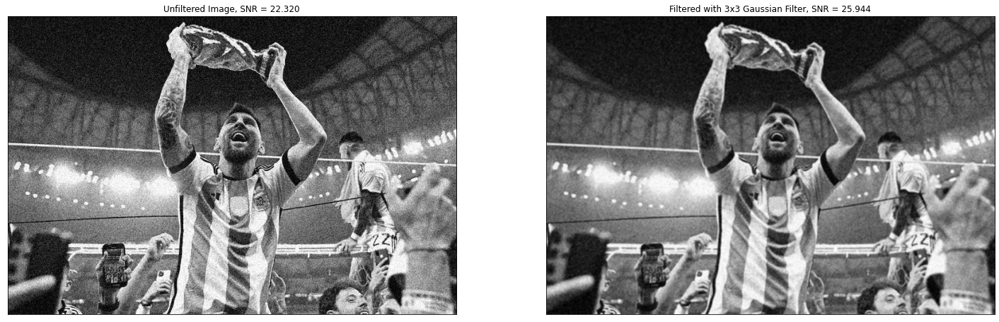

In [42]:
#Importing the neccessary libraries to implement task
import numpy as np
import cv2
import math
import matplotlib.pyplot as plt

#Mounting the google drive which contains the images to be processed
from google.colab import drive
drive.mount('/content/drive')

#Defining the path of the folder that contains our images 
path = '/content/drive/MyDrive/ECSE_415_W_2023/Assignments/Assignment1/images/'


def create_gaussian_filter(size, variance):
# Create an array of size x size
    filter = np.zeros((size, size))
    
# Center the array around the middle of the filter
    center = (size - 1) // 2
    
    for i in range(size):
        for j in range(size):
            x = i - center
            y = j - center
            
# Compute the Gaussian filter using the equation
            filter[i][j] = (1/(2*math.pi*(variance**2)))*(np.exp(-(x**2 + y**2) / (2 * (variance**2))))

# Normalize the filter so that the sum of all values is equal to 1
    filter = filter / np.sum(filter)
    
    return filter

#Get the clean image for comparison
clean_img_path = path + "messi.png"
clean_img = cv2.imread(clean_img_path, cv2.IMREAD_GRAYSCALE)

#Get the noisy image
noisy_img_path = path + "messi-gaussian.png"
noisy_img =  cv2.imread(noisy_img_path, cv2.IMREAD_GRAYSCALE)

#Calculate SNR of noisy image
noisy_SNR = cv2.PSNR(noisy_img, clean_img)

#Create our kernel
gaussian_filter = create_gaussian_filter(3,3)

#Filter our image
filtered_g = cv2.filter2D(noisy_img, cv2.CV_16S, gaussian_filter)

#Calculate the SNR
filtered_g = filtered_g.astype(clean_img.dtype)
filtered_g_SNR = cv2.PSNR(filtered_g, clean_img)



plt.figure(figsize=(25,25))
plt.subplot(121), plt.imshow(noisy_img, cmap='gray')
plt.title("Unfiltered Image, SNR = %.3f" %noisy_SNR), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(filtered_g, cmap='gray')
plt.title("Filtered with 3x3 Gaussian Filter, SNR = %.3f" %filtered_g_SNR), plt.xticks([]), plt.yticks([])
plt.show()


1.1.2 Using a Simple Box Filter 

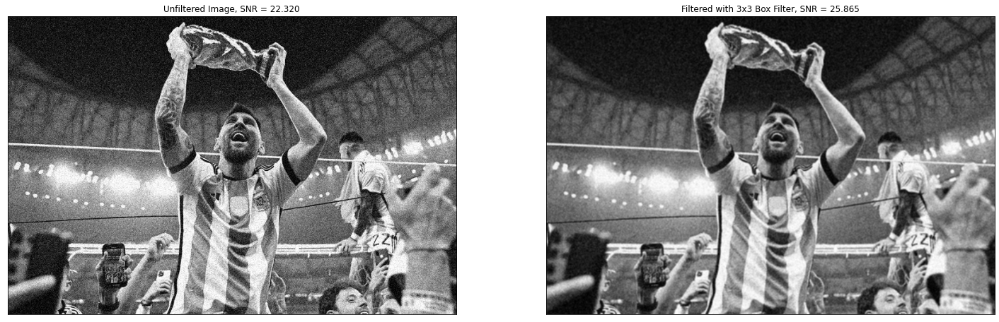

In [ ]:
#Now, using the same objects we have declared above, we implement the box filter in a similar fashion
#First, we create the function that makes the kernal according to a specified size
def create_box_filter(size):
    filter = np.ones((size, size)) / (size * size)
    return filter


#Create our kernal
box_filter = create_box_filter(3)

#Filter the image
filtered_b =  cv2.filter2D(noisy_img, cv2.CV_16S, box_filter)

#Calculate the SNR
filtered_b = filtered_b.astype(clean_img.dtype)
filtered_b_SNR = cv2.PSNR(filtered_b, clean_img)

plt.figure(figsize=(25,25))
plt.subplot(121), plt.imshow(noisy_img, cmap='gray')
plt.title("Unfiltered Image, SNR = %.3f" %noisy_SNR), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(filtered_b, cmap='gray')
plt.title("Filtered with 3x3 Box Filter, SNR = %.3f" %filtered_b_SNR), plt.xticks([]), plt.yticks([])
plt.show()


1.1.3 Comparison of Gaussian Filtering and Box Filtering

<p style='text-align: justify;'>When comparing the PSNR of a Gaussian filtered image to that of a box filtered image, the result may vary depending on the specific image and the level of noise present. In general, Gaussian filtering tends to give a higher PSNR than box filtering because it gives more weight to pixels that are closer to the target pixel and less weight to pixels that are further away [1]. This allows Gaussian filtering to preserve the edge information and overall structure of the image, leading to a higher PSNR.</p>

<p style='text-align: justify;'>As seen above, our noisy image has an PSNR of 22.320; our Gaussian filter, resulted in an image with a PSNR of 25.944, while the Box filtered image gave us a value of 25.865. As we can observe, our hypothesis above was indeed correct as the signal to noise ratio of our Gaussian filtered image is higher by 0.079. Albeit this is a small difference it still showcases that generally the Gaussian image filtering is superior in de-noising. However, if the image has a lot of fine details or high frequency information, Gaussian filtering may lead to blurring of the image and result in a lower PSNR. In such cases, box filtering may give a superior result in terms of PSNR.</p>
<br>
<br>

###1.2 Salt and Pepper Noise
1.2.1 Using a 3x3 Gaussian Filter (Variance = 3) on Salt and Pepper Noise

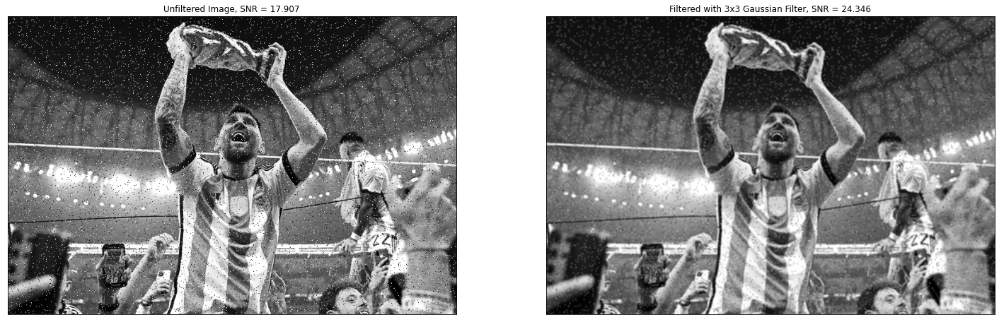

In [ ]:
#Fetching the image with salt and pepper noise
sp_noisy_img_path = path + "salt-and-pepper-messi2.png"
sp_noisy_img = cv2.imread(sp_noisy_img_path, cv2.IMREAD_GRAYSCALE)

#Calculate SNR of salt and pepper noisy image
sp_noisy_SNR = cv2.PSNR(sp_noisy_img, clean_img)

#Filter our image
sp_filtered_g = cv2.filter2D(sp_noisy_img, cv2.CV_16S, gaussian_filter)

#Calculate the SNR
sp_filtered_g = sp_filtered_g.astype(clean_img.dtype)
sp_filtered_g_SNR = cv2.PSNR(sp_filtered_g, clean_img)

plt.figure(figsize=(25,25))
plt.subplot(121), plt.imshow(sp_noisy_img, cmap='gray')
plt.title("Unfiltered Image, SNR = %.3f" %sp_noisy_SNR), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(sp_filtered_g, cmap='gray')
plt.title("Filtered with 3x3 Gaussian Filter, SNR = %.3f" %sp_filtered_g_SNR), plt.xticks([]), plt.yticks([])
plt.show()

1.2.2 Using a Median Filter on Salt and Pepper Noise

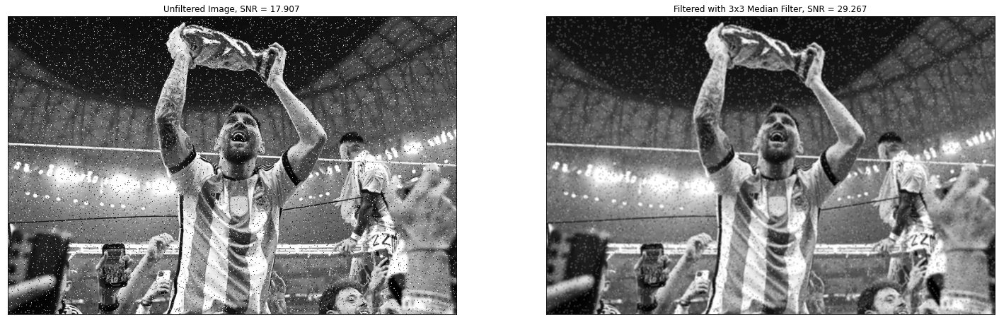

In [ ]:
# Code adapted from Tutorial 2 of ECSE 415 
# Author: Amar Kumar
# Description: This function creates a median filter according to the instructions provided in Tutorial 2 of the ECSE415 class. 

def median_filter(input_image, kernel_size):
# calculate pad_size
# in case of 3x3 kernel_size, we want to pad each side with 1 new pixel
    pad_size = np.floor(kernel_size/2).astype("uint8")

# pad image. Here we are using constant padding with constant=0, basically zero_padding
    pad_input_image = np.pad(input_image, pad_width=int(pad_size), mode='constant', constant_values=0)

# Get Height and Width of the original image.
    h, w = pad_input_image.shape # (392,514)

# initialize output image to be similar to original image size
    output_image = np.zeros_like(input_image)

# Now Traverse through image using two for loops
    for i in range(0, h - 2*pad_size): # 0, 390 because when we are at 390, we take values between 390-392
        for j in range(0, w - 2*pad_size): # 0, 512
            output_image[i,j] = np.median(pad_input_image[i:i+kernel_size, j:j+kernel_size])

# return output
    return output_image
    
# End of code adapted from Tutorial 2

#Now filtering our image using a median filter
sp_filtered_m =  median_filter(sp_noisy_img, 3)
sp_filtered_m_SNR = cv2.PSNR(sp_filtered_m, clean_img)

plt.figure(figsize=(25,25))
plt.subplot(121), plt.imshow(sp_noisy_img, cmap='gray')
plt.title("Unfiltered Image, SNR = %.3f" %sp_noisy_SNR), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(sp_filtered_g, cmap='gray')
plt.title("Filtered with 3x3 Median Filter, SNR = %.3f" %sp_filtered_m_SNR), plt.xticks([]), plt.yticks([])
plt.show()

1.2.3 Comparison of Gaussian Noise and Salt and Pepper Noise

Gaussian noise is a type of random noise that has a normal distribution and is distributed evenly across the image. It results in a blurry effect and a decrease in the overall contrast of the image. On the other hand, salt and pepper noise is a type of noise where a small number of pixels in the image have values that are significantly different from their surrounding pixels. This results in random white and black dots in the image as seen in the plots in 1.2.1 and 1.2.2.

The best denoising method for these two types of noisy images can vary. Gaussian denoising works well for Gaussian noise as it is specifically designed to remove Gaussian noise. This is seen and described in 1.1.3, where we found that the Gaussian filter results in a higher SNR than the Box filter. 

Median denoising is often the best method for removing salt and pepper noise as it replaces the outlier pixel values with the median of the surrounding pixels, effectively removing the noise while preserving the original image details. Box denoising is not as effective as it gives equal value to all pixels in the kernal; but it is a simple and fast method that can be used to remove both Gaussian noise and salt and pepper noise. This is further validated through our findings as we find that a Gaussian filter over salt and pepper noise resulted in a PSNR of 24.346, while the median filter resulted in a value of 29.267. [1]
<b> 
<b> 
##2. Canny Edge Detection
###2.1 Canny Edge Detection Description
<b> 

Canny edge detection can be described in 4 stages as follows: 

1. Gaussian Blur: The target image is filtered using a Gaussian kernel in order to reduce noise. This helps eliminate random noise or discrepancies that could affect the edge detection. 

2. Gradient Calculation: The magnitude and orientation of the gradient is calculated for both the horizontal and vertical components of the gradient. The magnitude and direction of these components are used to identify edges. 

3. Non-Maximum Suppression: In this step, the gradient magnitude of each pixel is compared with the gradient magnitudes of its neighbours in the gradient direction. The multi-pixel wide “ridges” are thinned down to a single edge-pixel wide representation of the image.

4. Thresholding and Linking (Hysteresis): At this stage, the edge pixels are threshold-ed as such that only the strongest edges are kept. Two thresholds are selected: a maximum and a minimum threshold. The edges that have gradient magnitudes that are greater than the maximum thresholds are used as starting points to creating edge curves. Edges with a gradient magnitude less than the minimum are subdued; while edges that exist between range are used to continue the edge curves. [2]


##2.2 Parameters within Canny Edge Detection
2.2.1 Varying the Parameters of Canny Edge Detection


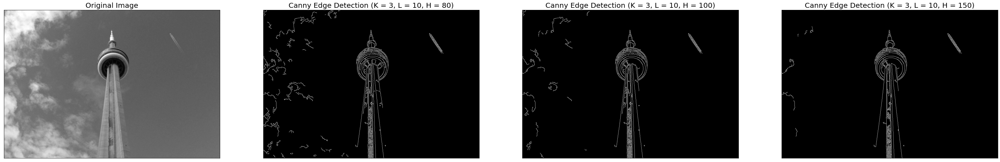

In [ ]:
#Fetching the image to be performed canny edge detection on
edge_img_path = path + "cntower.jpg"
edge_img = cv2.imread(edge_img_path, cv2.IMREAD_GRAYSCALE)

#Step 1: Gaussian Blur
edge_img_g = cv2.GaussianBlur(edge_img, (3, 3), 1)
#Step 2,3,4: Canny Edge Detection
img_edge_cv0 = cv2.Canny(edge_img_g, 10, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 10, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 10, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 10, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 10, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 10, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

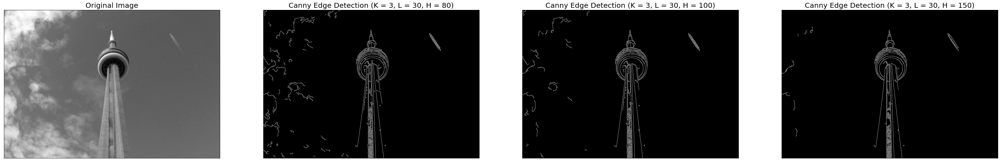

In [ ]:
#Now, varying the maximum threshold with K = 3, L = 30

img_edge_cv0 = cv2.Canny(edge_img_g, 30, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 30, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 30, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 30, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 30, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 30, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()


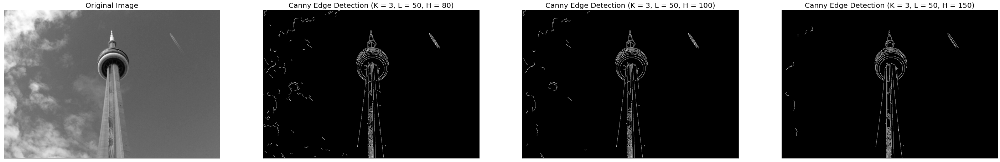

In [ ]:
#Now, varying the maximum threshold with K = 3, L = 50
img_edge_cv0 = cv2.Canny(edge_img_g, 50, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 50, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 50, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 50, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 50, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 3, L = 50, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

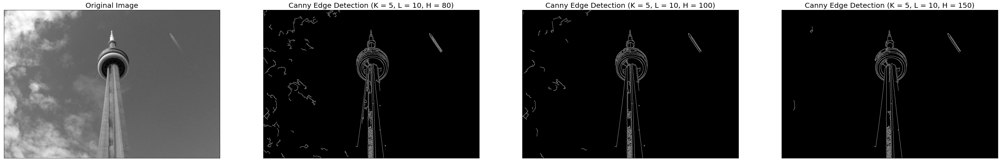

In [ ]:
#Now, varying the maximum threshold with K = 5, L = 10

#Step 1: Gaussian Blur
edge_img_g = cv2.GaussianBlur(edge_img, (5, 5), 1)

img_edge_cv0 = cv2.Canny(edge_img_g, 10, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 10, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 10, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 10, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 10, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 10, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

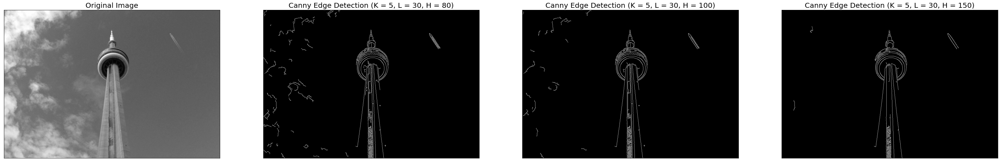

In [ ]:
#Now, varying the maximum threshold with K = 5, L = 30

img_edge_cv0 = cv2.Canny(edge_img_g, 30, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 30, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 30, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 30, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 30, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 30, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

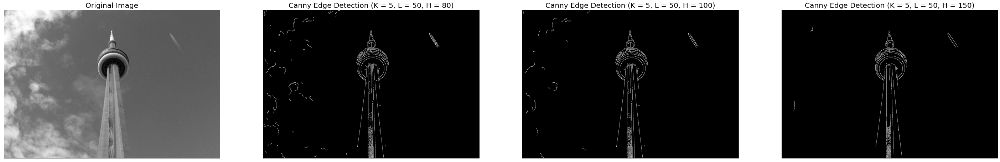

In [ ]:
#Now, varying the maximum threshold with K = 5, L = 50
img_edge_cv0 = cv2.Canny(edge_img_g, 50, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 50, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 50, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 50, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 50, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 50, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

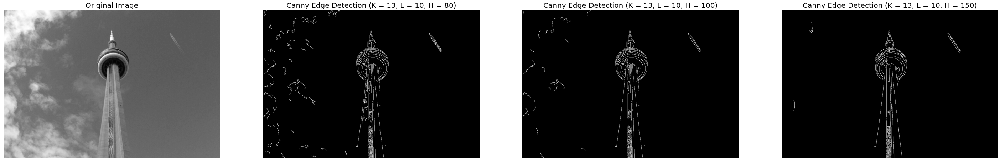

In [ ]:
#Now, varying the maximum threshold with K = 13, L = 10

#Step 1: Gaussian Blur
edge_img_g = cv2.GaussianBlur(edge_img, (13, 13), 1)

img_edge_cv0 = cv2.Canny(edge_img_g, 10, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 10, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 10, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 10, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 10, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 10, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

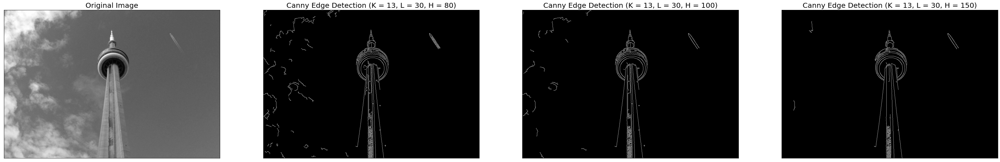

In [ ]:
#Now, varying the maximum threshold with K = 13, L = 30

img_edge_cv0 = cv2.Canny(edge_img_g, 30, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 30, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 30, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 30, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 30, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 30, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

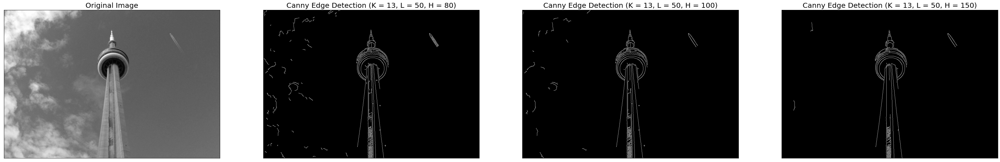

In [ ]:
#Now, varying the maximum threshold with K = 13, L = 50
img_edge_cv0 = cv2.Canny(edge_img_g, 50, 80)

img_edge_cv1 = cv2.Canny(edge_img_g, 50, 100)

img_edge_cv2 = cv2.Canny(edge_img_g, 50, 150)

# display images
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv0, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 50, H = 80)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 50, H = 100)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 13, L = 50, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

##2.3 Effects of Parameters on Canny Edge Detection Results

As observed from the plots above, each parameter within the canny edge detection technique affects the results. We begin our discussion with first examining the effects of the lower threshold. As stated previously, we understand that the lower threshold L, specifies the lower limit of edge intensity; where edges that have a lower intensity than this value are removed from the result. We can observe this through our results as our final output images contain less ‘details’ as we increase the lower threshold. This is plausible as more edges, that do not make the threshold of intensity are being omitted; hence it is preferred, in this instance to keep our lower threshold in a higher range as this helps omit weak edges such as the clouds in the image. However, one must be careful not to set this parameter too high as it will result in too many edges being omitted which may result in crucial or ‘hard’ edges being omitted as seen with the right edge of the CN tower, which decreases in visibility as we increase the lower threshold.

As for the higher threshold H, we recognize that the edges with intensity above it are traced as strong edges, while the edges that have intensity between the two thresholds are traced as weak edges if they are connected to a strong edge. As we can see from our varying plots in all cases; increasing the maximum threshold reduces the number of weak edges in the output. That is, as we increase the higher threshold, our result seems to omit more of the ‘weak’ edges such as the clouds and details of the passing plane. 

The kernel size K determines the size of the neighbourhood used to blur the image before edge detection happens. Increasing the kernel size results in more smoothing of the image and less noise. The effect of this smoothing however also leads to blurred edges, which makes the size of the detected edges ‘larger’. As seen from our results, as we increase the kernel size we lose more ‘details’ in our resulting edge detection. These details result in accurate edge detection in some cases, and in other cases introduce ‘weak’ edges from the clouds. 

We can infer from our findings, that since the lower threshold and the kernel size directly affects the details within the image, that these parameters are related. More specifically, when it comes to choosing one of these two parameters, the other should be considered as they affect similar components of the edge detection.

##2.4 Optimized Parameters for Cany Edge Detection

After examining our 27 output combinations, we have come to conclude that the best result was in the instance of canny edge detection with K = 5, L = 50, H = 150. This result is showcased below for reference. It should be noted that there might be better combinations of parameters; however this is best solution for the tested parameters. 

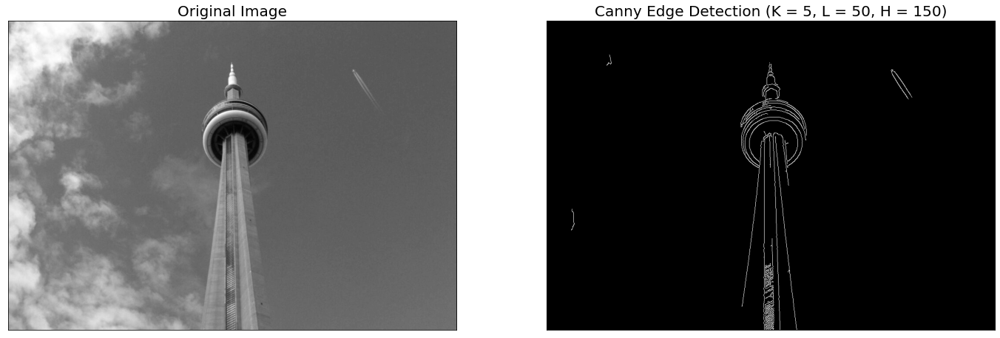

In [ ]:
edge_img_g = cv2.GaussianBlur(edge_img, (5, 5), 1)

img_edge_cv2 = cv2.Canny(edge_img_g, 50, 150)
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(edge_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Canny Edge Detection (K = 5, L = 50, H = 150)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

#3. Harris Corner Detection
##3.1 Maze Image
As seen from the plots below, we ran our implemented Harris Corner detector on the target image using three varying thresholds, 0.1, 0.9 and 0.001. It should be noted that we chose to implement our threshold as a fraction of the maximum possible ‘cornerness’. This is primarily done to allow the algorithm to be robust and versatile, allowing us to run any image with any range of values of cornerness. And so, our algorithm does this by multiplying the threshold with the maximum value of cornerness in our image, anything below this threshold is removed from the array holding our values. More specifically this happens in the line: 

R[R < threshold*R.max()] = 0

After running the algorithm on the maze image, we can see that our chosen standard threshold of 0.1 results in an image close to that of the example given in the assignment manual. That is, any value of cornerness that is below 10% of the highest cornerness value is omitted before non-maximum suppression takes place. As observed from our results, as we increase the threshold to 0.9, we lose many of the corners that were detected initially. On the other hand, when the threshold is decreased to only 0.001, we achieve similar results to our 0.1 threshold. This is plausible as the image is simple and free from ‘high level features’, and so decreasing the threshold should not result in too much of a change considering that the window we perform non-maximum suppression on is of a value of 10x10. 


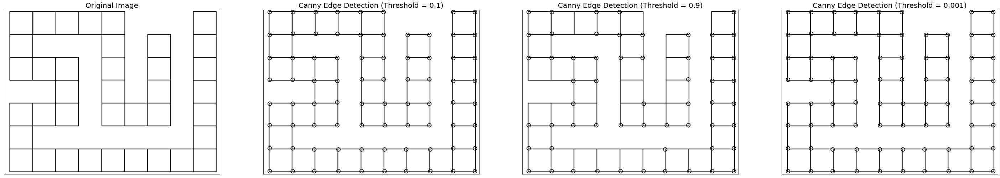

In [63]:
def Harris_corner_detection(img, k=0.05, threshold=0.1):
# Blur the image with a Gaussian blur
    blurred = cv2.GaussianBlur(img, (5, 5), 0)

# Compute the image derivatives
    sobelx = cv2.Sobel(blurred, cv2.CV_32F, 1, 0, ksize=3)
    sobely = cv2.Sobel(blurred, cv2.CV_32F, 0, 1, ksize=3)

# Compute the square of the derivatives
    Ixx = sobelx**2
    Iyy = sobely**2
    Ixy = sobelx * sobely

# Apply Gaussian filtering on the output of step 3
    window_size = 5
    Ixx = cv2.GaussianBlur(Ixx, (window_size, window_size), 0)
    Iyy = cv2.GaussianBlur(Iyy, (window_size, window_size), 0)
    Ixy = cv2.GaussianBlur(Ixy, (window_size, window_size), 0)

# Compute the cornerness function response
    height, width = blurred.shape
    R = np.zeros((height, width))
    for y in range(height):
        for x in range(width):
            S = np.array([[Ixx[y,x], Ixy[y,x]], [Ixy[y,x], Iyy[y,x]]])
            det = np.linalg.det(S)
            trace = np.trace(S)
            R[y,x] = det - k * (trace**2)

# Perform non-maximum suppression
# Code adapted from Tutorial 2 of ECSE 415 
# Author: Amar Kumar
# Description: This segment of code serves as the NMS process; using a 10x10 window to remove 'duplicate' points by chossing the maximum of them within the window
    R[R < threshold*R.max()] = 0

    window_size = 10
    rows, cols = len(R), len(R[0])
    for i in range(rows):
        for j in range(cols):
            max_val = R[i][j]
            max_i, max_j = i, j
            for ii in range(max(0, i - window_size // 2), min(rows, i + window_size // 2 + 1)):
                for jj in range(max(0, j - window_size // 2), min(cols, j + window_size // 2 + 1)):
                    if R[ii][jj] > max_val:
                        max_val = R[ii][jj]
                        max_i, max_j = ii, jj
            for ii in range(max(0, i - window_size // 2), min(rows, i + window_size // 2 + 1)):
                for jj in range(max(0, j - window_size // 2), min(cols, j + window_size // 2 + 1)):
                    if ii != max_i or jj != max_j:
                        R[ii][jj] = 0
#End of segment adapted from Tutorial 2

# Find the coordinates of the corners
    coords = np.column_stack(np.where(R > 0))

# Create a copy of the original image to draw on
    output_img = img.copy()

    unique_coordinates = []
    for coordinate in coords:
        if not np.any([np.all(coordinate == uc) for uc in unique_coordinates]):
            unique_coordinates.append(coordinate)


# Draw circles on the corners
    for coord in unique_coordinates:
        y, x = coord
        cv2.circle(output_img, (x, y), 10, (0, 0, 255), 2)

    return output_img


corner_img_path = path + "template_board.png"
corner_img = cv2.imread(corner_img_path, cv2.IMREAD_GRAYSCALE)

output = Harris_corner_detection(corner_img, 0.05, 0.1)
output1 = Harris_corner_detection(corner_img, 0.05, 0.9)
output2 = Harris_corner_detection(corner_img, 0.05, 0.001)

plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(corner_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(output, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.1)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(output1, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.9)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(output2, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.001)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

###3.2 Shape Image
As seen from the plots below, we arrive at similar results using our shapes image. With a threshold of 0.1, our algorithm was able to detect 26 corners, most of which are quite accurate in terms of corner detection. The trial with a threshold of 0.9 on the other hand only detected 1 corner. Lastly, the run with a threshold of 0.001, detected around 75 corners, some of which barely qualify as corners. This allows us to recognize the parameters effect on corner detection as; the higher the threshold value is, the ‘stricter’ the algorithm is in specifying if a feature is a corner, recognizing in general less corners. Contrary, a low threshold, allows for many more points in the photo to qualify as corners and even results in some false detections.

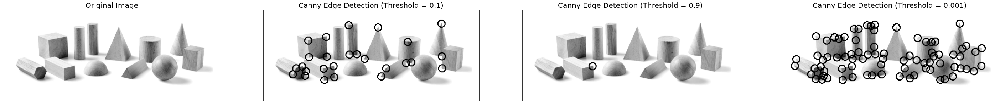

In [61]:
#Fetching the desired image
corner_img_path = path + "shapes.png"
corner_img = cv2.imread(corner_img_path, cv2.IMREAD_GRAYSCALE)

#Calling the harris corner detector function we implemented earlier
output = Harris_corner_detection(corner_img, 0.05, 0.1)
output1 = Harris_corner_detection(corner_img, 0.05, 0.9)
output2 = Harris_corner_detection(corner_img, 0.05, 0.001)

plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(corner_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(output, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.1)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(output1, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.9)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(output2, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.001)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

##3.3 Building Image

We arrived at similar results for when the image under examination the building image. As seen from the plots below, a threshold of 0.1, allows detection of most of the correct corners in the image. While some of them are missed, this can be avoided by continuing to vary the threshold until a desired output is realized. A threshold of 0.9 only recognizes 1 corner, which follows the analysis conducted in the previous sections of part 3 of this investigation. Finally, a threshold of 0.001 results in many more corner detections compared to our initial detection. It is concluded from this section that generally; more corners are detected as the threshold is decreased; and this is due to the threshold being a main criterion for candidate corners.

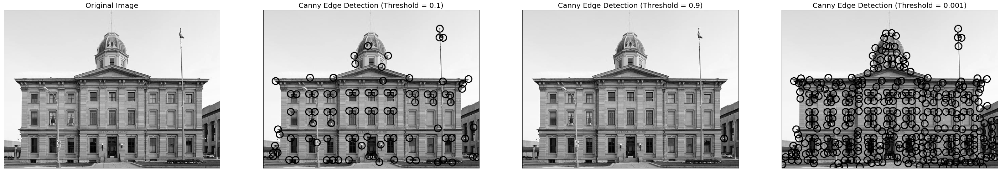

In [62]:
#Fetching the desired image
corner_img_path = path + "courthouse.jpg"
corner_img = cv2.imread(corner_img_path, cv2.IMREAD_GRAYSCALE)

#Calling the harris corner detector function we implemented earlier on all variations
output = Harris_corner_detection(corner_img, 0.05, 0.1)
output1 = Harris_corner_detection(corner_img, 0.05, 0.9)
output2 = Harris_corner_detection(corner_img, 0.05, 0.001)

#Displaying the image
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(corner_img, cmap="gray")
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(output, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.1)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(output1, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.9)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(output2, cmap="gray")
plt.title("Canny Edge Detection (Threshold = 0.001)", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

#4. Invariance of SIFT Features

##4.1 SIFT Description
The four main steps of the SIFT method can be described as follows: 

1.Key Point Detection: The input image is blurred to create a scale-space representation. Keypoint locations are then found as local extrema across a Scale-Space Image Pyramid. 

2. SIFT Key Localization: Refines the location of keypoints by fitting a detailed model to the scale-space extrema. This detailed model is often the Laplacian-of-Gaussian. 

3. Eliminate unstable keypoints: Some keypoints from the many that were generated, lie along an edge, and/or have low contrast. In both cases, they are not useful as features, so we elliminate them. 

4. Select canonical orientation for the SIFT key: Assigns an orientation to each keypoint based on the dominant gradient direction in its local neighborhood.

##4.2 Invariance Under Scale
###4.2.1 SIFT Features

(Text(0.5, 1.0, 'SIFT Feature Detection'),
 ([], <a list of 0 Text major ticklabel objects>),
 ([], <a list of 0 Text major ticklabel objects>))

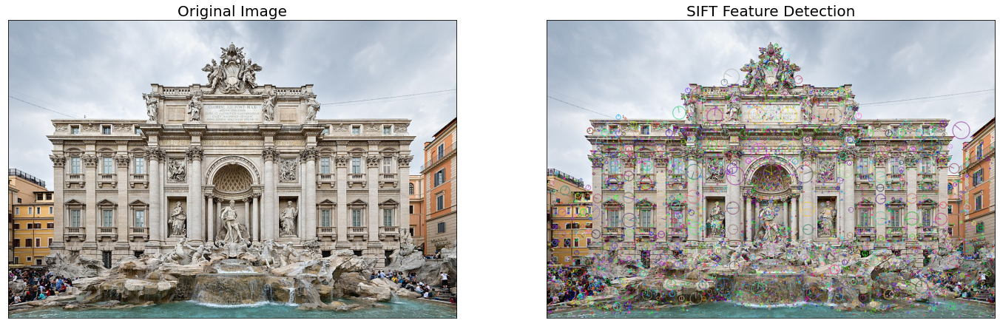

In [77]:
import cv2
import numpy as np

# Load the image
img_path = path + "TreviFountainRome.jpg"
img = cv2.imread(img_path)

def SIFT_detection(picture):

    picture = cv2.cvtColor(picture, cv2.COLOR_BGR2RGB)
    img_disp = picture.copy()
    img_disp = cv2.cvtColor(img_disp, cv2.COLOR_BGR2RGB)

# Initialize the SIFT detector
    sift = cv2.xfeatures2d.SIFT_create()

# Compute the SIFT keypoints
    keypoints = sift.detect(img_disp, None)

# Draw the keypoints on the image
    img_keypoints = cv2.drawKeypoints(img_disp, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    return img_keypoints

detected_img = SIFT_detection(img)
# Display the result
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("Original Image", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB))
plt.title("SIFT Feature Detection", fontsize = 20), plt.xticks([]), plt.yticks([])




###4.2.2 Scaling the Reference Image



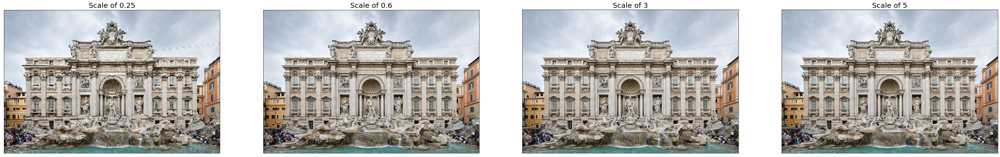

In [73]:
# Load the image
img = cv2.imread(img_path)

# Get the original size of the image
height, width = img.shape[:2]

# Specify the scaling factor
scale_factor = 0.25
# Calculate the size of the resized image
dsize = (int(width * scale_factor), int(height * scale_factor))
# Resize the image using linear interpolation
resized_img = cv2.resize(img, dsize, interpolation=cv2.INTER_LINEAR)

# Specify the scaling factor
scale_factor = 0.6
# Calculate the size of the resized image
dsize = (int(width * scale_factor), int(height * scale_factor))
# Resize the image using linear interpolation
resized_img1 = cv2.resize(img, dsize, interpolation=cv2.INTER_LINEAR)

# Specify the scaling factor
scale_factor = 3
# Calculate the size of the resized image
dsize = (int(width * scale_factor), int(height * scale_factor))
# Resize the image using linear interpolation
resized_img2 = cv2.resize(img, dsize, interpolation=cv2.INTER_LINEAR)

# Specify the scaling factor
scale_factor = 5
# Calculate the size of the resized image
dsize = (int(width * scale_factor), int(height * scale_factor))
# Resize the image using linear interpolation
resized_img3 = cv2.resize(img, dsize, interpolation=cv2.INTER_LINEAR)

plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.25", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(resized_img1, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.6", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(resized_img2, cv2.COLOR_BGR2RGB))
plt.title("Scale of 3", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(resized_img3, cv2.COLOR_BGR2RGB))
plt.title("Scale of 5", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

###4.2.3 Compute SIFT keypoints for all (total 4) transformed images.

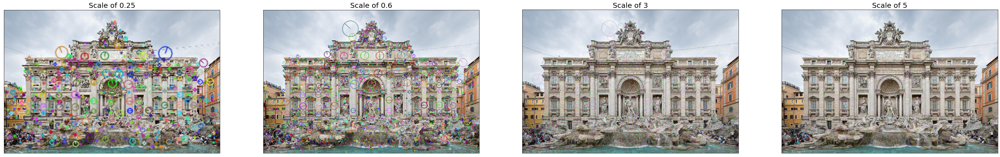

In [78]:
#Calling our defined SIFT_detection function in order to draw keypoints on variations of scaled image 
scale_sift = SIFT_detection(resized_img)
scale_sift1 = SIFT_detection(resized_img1)
scale_sift2 = SIFT_detection(resized_img2)
scale_sift3 = SIFT_detection(resized_img3)

#Displaying the resulting images 
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(scale_sift, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.25", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(scale_sift1, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.6", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(scale_sift2, cv2.COLOR_BGR2RGB))
plt.title("Scale of 3", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(scale_sift3, cv2.COLOR_BGR2RGB))
plt.title("Scale of 5", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

###4.2.4 Matching all keypoints of the reference image to the transformed images

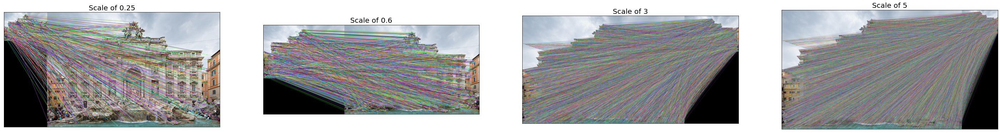

In [85]:
def match_keypoints(img1, img2):
    # Create SIFT detector object
    sift = cv2.xfeatures2d.SIFT_create()

    # Detect keypoints and compute descriptors for both images
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    # Use BFMatcher to find matches between the descriptors
    bf = cv2.BFMatcher()
    matches = bf.match(des1, des2)

    matches = sorted(matches, key = lambda x:x.distance)

    # Draw the matches on a new image
    result = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    return result

    #Calling our defined function in order to fetch results
matched_img = match_keypoints(resized_img, img)
matched_img1 = match_keypoints(resized_img1, img)
matched_img2 = match_keypoints(resized_img2, img)
matched_img3 = match_keypoints(resized_img3, img)



plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(matched_img, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.25", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(matched_img1, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.6", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(matched_img2, cv2.COLOR_BGR2RGB))
plt.title("Scale of 3", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(matched_img3, cv2.COLOR_BGR2RGB))
plt.title("Scale of 5", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

  

###Displaying the Top 10 Matched Keypoints

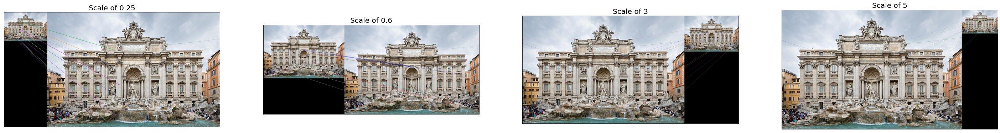

In [96]:
#This function is identical to the one above with the same name, however, this function also draws the matches that were found on a new
# output image
def match_keypoints2(img1, img2):
    # Create SIFT detector object
    sift = cv2.xfeatures2d.SIFT_create()

    # Detect keypoints and compute descriptors for both images
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    matches = []
    # Use BFMatcher to find matches between the descriptors
    bf = cv2.BFMatcher()
    matches = bf.match(des1, des2)

    matches = sorted(matches, key = lambda x:x.distance)

    # Draw the matches on a new image
    result = cv2.drawMatches(img1,kp1,img2,kp2, matches[:10], None, flags=2)

    return result

#Passing our scaled images to the function
matched_img = match_keypoints2(resized_img, img)
matched_img1 = match_keypoints2(resized_img1, img)
matched_img2 = match_keypoints2(resized_img2, img)
matched_img3 = match_keypoints2(resized_img3, img)


#Displaying the Result
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(matched_img, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.25", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(matched_img1, cv2.COLOR_BGR2RGB))
plt.title("Scale of 0.6", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(matched_img2, cv2.COLOR_BGR2RGB))
plt.title("Scale of 3", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(matched_img3, cv2.COLOR_BGR2RGB))
plt.title("Scale of 5", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

##4.2 Invariance Under Scale: Results 

As seen from the four plots below, the matching distance of the best 100 matches that the SIFT method reached are similar accross all scalings. This is because the SIFT descriptor is invariant to scale. This means that increasing the scale of an image will result in the same SIFT descriptor, regardless of the scale factor used. 

This result is true for nearly all outputs as we observe a very similar trendline accross all scales. It should be noted however, that very large scale changes could eventually lead to loss of information (if we are scaling down). This can result in a less reliable SIFT operation on the image as details of the image will be lost. This can be seen as the matching distance for the scale of 0.25 seems to have a less steep gradient compared to the other plots. [3]



<Figure size 3600x1800 with 0 Axes>

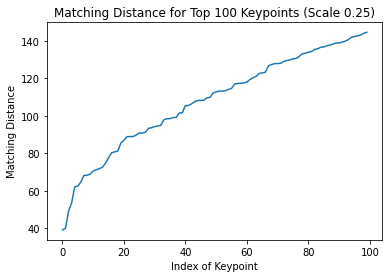

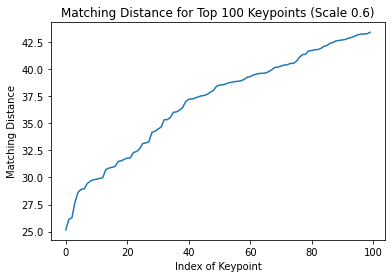

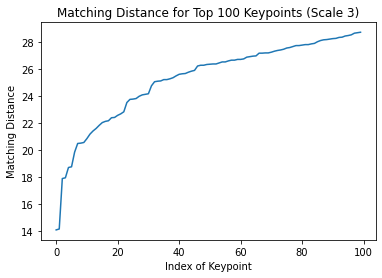

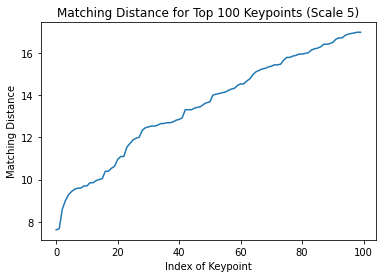

In [112]:
def match_finder(img1, img2):
    # Create SIFT detector object
    sift = cv2.xfeatures2d.SIFT_create()

    # Detect keypoints and compute descriptors for both images
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    # Use BFMatcher to find matches between the descriptors
    bf = cv2.BFMatcher()
    matches = bf.match(des1, des2)
    #Sort matches using built in function
    matches = sorted(matches, key = lambda x:x.distance)

    return matches

#Fetch the list of matches from our match_finder function
match_plot = match_finder(resized_img, img)
match_plot1 = match_finder(resized_img1, img)
match_plot2 = match_finder(resized_img2,img)
match_plot3 = match_finder(resized_img3, img)



# Plot the matching distance for the top 100 matched keypoints
top_100 = match_plot[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
plt.figure(figsize=(50, 25))
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Scale 0.25)')

top_100 = match_plot1[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Scale 0.6)')

top_100 = match_plot2[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Scale 3)')

top_100 = match_plot3[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Scale 5)')




plt.show()

#4.3 Invariance Under Rotation

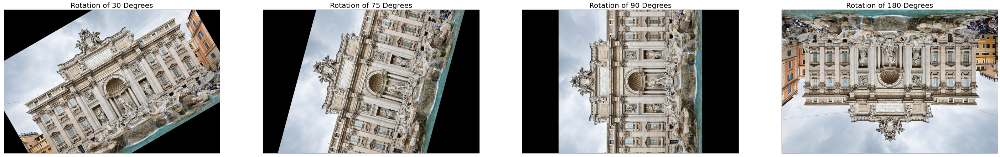

In [122]:
# Code adapted from OpenCV-Python Tutorials
# OpenCV-Python Tutorials - A library of programming functions mainly aimed at real-time computer vision
# Feb 8, 2023
def rotate_image(image, angle):
    height, width = image.shape[:2]

    # get the rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)

    # perform the rotation
    rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))

    return rotated_image

#End of code adapted from OpenCV-Python Tutorials
#Fetch the target image
img = cv2.imread(img_path)

#Call rotate image on our target image
rotated_img = rotate_image(img, 30)
rotated_img1 = rotate_image(img, 75)
rotated_img2 = rotate_image(img, 90)
rotated_img3 = rotate_image(img, 180)

#Display the results
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(rotated_img, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 30 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(rotated_img1, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 75 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(rotated_img2, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 90 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(rotated_img3, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 180 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()



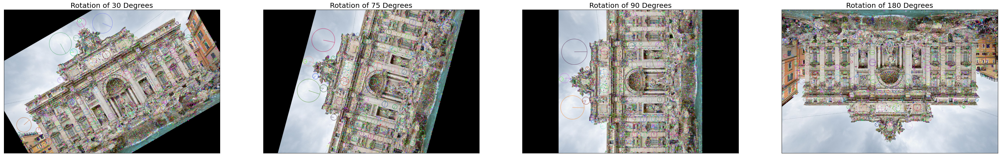

In [114]:
#Call our sift detection function on our rotated images
rot_sift = SIFT_detection(rotated_img)
rot_sift1 = SIFT_detection(rotated_img1)
rot_sift2 = SIFT_detection(rotated_img2)
rot_sift3 = SIFT_detection(rotated_img3)

#Display the results of our sift detection
plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(rot_sift, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 30 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(rot_sift1, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 75 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(rot_sift2, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 90 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(rot_sift3, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 180 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

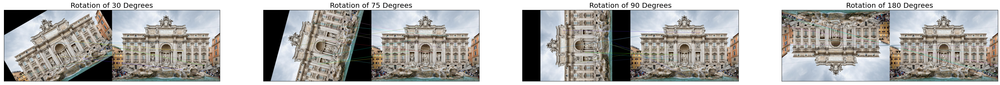

In [124]:
#Reusing the same function we implemented earlier in order to avoid errors in running

def match_keypoints2(img1, img2):
    # Create SIFT detector object
    sift = cv2.xfeatures2d.SIFT_create()

    # Detect keypoints and compute descriptors for both images
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    matches = []
    # Use BFMatcher to find matches between the descriptors
    bf = cv2.BFMatcher()
    matches = bf.match(des1, des2)

    matches = sorted(matches, key = lambda x:x.distance)

    # Draw the matches on a new image
    result = cv2.drawMatches(img1,kp1,img2,kp2, matches[:10], None, flags=2)

    return result

#Call our match drawing function on our rotated images    
matched_img = match_keypoints2(rotated_img, img)
matched_img1 = match_keypoints2(rotated_img1, img)
matched_img2 = match_keypoints2(rotated_img2, img)
matched_img3 = match_keypoints2(rotated_img3, img)



plt.figure(figsize=(50, 25))
plt.subplot(1,4,1), plt.imshow(cv2.cvtColor(matched_img, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 30 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,2), plt.imshow(cv2.cvtColor(matched_img1, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 75 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,3), plt.imshow(cv2.cvtColor(matched_img2, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 90 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.subplot(1,4,4), plt.imshow(cv2.cvtColor(matched_img3, cv2.COLOR_BGR2RGB))
plt.title("Rotation of 180 Degrees", fontsize = 20), plt.xticks([]), plt.yticks([])
plt.show()

##4.3 Invariance Under Rotation: Results

As seen from our plots below, it seems like the SIFT operation is invariant to rotations. This is becaus the plots follow a very similar projection and trendline to each other. It is noted that some descrepincies occur in some stages as some rotations can cause the keypoints to become occluded, which can make them harder to detect and match. This can lead to even larger matching distances and further degradation of the results. This is what we hypothesise happens when the image is rotated by 180 degrees; as our plot for that instance seems to be 0 accross all keypoints. This follows from theory as SIFT is also rotation invarient. This means that rotating an image will not change the SIFT descriptor, regardless of the angle of rotation used. [3]

It is further noted that the plot for 180 degree rotation could be an anomoly or error in code. 



<Figure size 3600x1800 with 0 Axes>

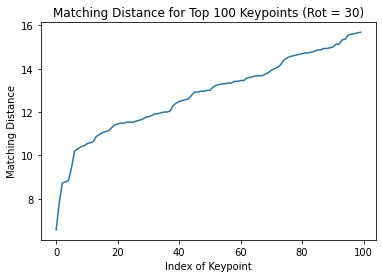

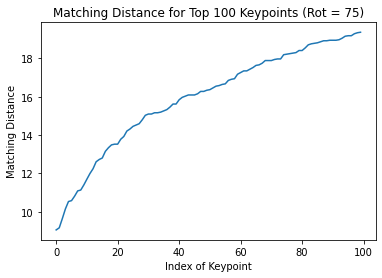

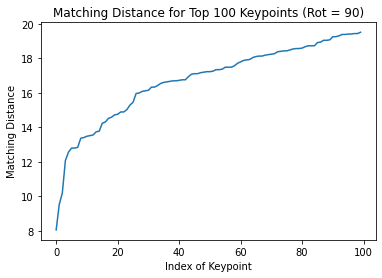

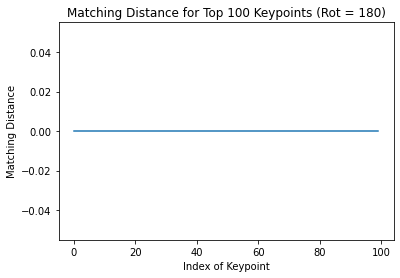

In [125]:
#Using our earlier implemented function to fetch the list of matches of our rotated images
match_plot = match_finder(rotated_img, img)
match_plot1 = match_finder(rotated_img1, img)
match_plot2 = match_finder(rotated_img2,img)
match_plot3 = match_finder(rotated_img3, img)


# Plot the matching distance for the top 100 matched keypoints
top_100 = match_plot[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
plt.figure(figsize=(50, 25))
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Rot = 30)')

top_100 = match_plot1[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Rot = 75)')

top_100 = match_plot2[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Rot = 90)')

top_100 = match_plot3[:100]
x = np.arange(len(top_100))
y = [kp.distance for kp in top_100]
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_xlabel('Index of Keypoint')
ax.set_ylabel('Matching Distance')
ax.set_title('Matching Distance for Top 100 Keypoints (Rot = 180)')




plt.show()

Works Cited: 

[1]T. Arbel, “Lecture 3 – Low-Level Vision and Image Filtering,” presented at the Lecture, Jan. 2023.

[2]T. Arbel, “Lecture 4 – Edge Detection,” presented at the Lecture, Jan. 2023.

[3]D. G. Lowe, “Distinctive Image Features from Scale-Invariant Keypoints,” International Journal of Computer Vision, vol. 60, no. 2, pp. 91–110, Nov. 2004, doi: https://doi.org/10.1023/b:visi.0000029664.99615.94.

[4]OpenCV, “OpenCV,” opencv.org. https://docs.opencv.org/4.6.0/
‌